In [1]:
# Import packages and dependencies
import os
import glob
import pandas as pd
import numpy as np; np.random.seed(sum(map(ord, 'calmap')))
from matplotlib import colors
import io
import matplotlib.pyplot as plt
import calmap


# We configure pandas in order to see the complete rows and columns of our data frames
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)

In [2]:

# All files downloaded from the 
all_filenames = [i for i in glob.glob("Historico Sinave/*.csv")]
# all_filenames

In [3]:
df_exploration = pd.read_csv(all_filenames[0])
df_exploration.head()

,alcaldia,colonia,clave_colonia,total_200629,total_200630,total_200701
0,GUSTAVO A. MADERO,BENITO JUAREZ,05-011,NaN,6.0,NaN
1,GUSTAVO A. MADERO,CONSTITUCION DE LA REPUBLICA,05-029,8.0,7.0,NaN
2,GUSTAVO A. MADERO,CUCHILLA DEL TESORO,05-035,12.0,11.0,11.0
3,GUSTAVO A. MADERO,GERTRUDIS SANCHEZ 2A SECCION,05-067,7.0,NaN,NaN
4,GUSTAVO A. MADERO,MARTIRES DE RIO BLANCO,05-124,8.0,8.0,8.0


In [4]:
for f in all_filenames:
    print("---------------------")
    print("The file is "+ f)
    print(pd.read_csv(f).columns)

---------------------
The file is Historico Sinave\200701_base_historica.csv
Index(['alcaldia', 'colonia', 'clave_colonia', 'total_200629', 'total_200630',
       'total_200701'],
      dtype='object')
---------------------
The file is Historico Sinave\200702_base_historica.csv
Index(['alcaldia', 'colonia', 'clave_colonia', 'total_200629', 'total_200630',
       'total_200701', 'total_200702'],
      dtype='object')
---------------------
The file is Historico Sinave\200703_base_historica.csv
Index(['alcaldia', 'colonia', 'clave_colonia', 'total_200629', 'total_200630',
       'total_200701', 'total_200702', 'total_200703'],
      dtype='object')
---------------------
The file is Historico Sinave\200704_base_historica.csv
Index(['alcaldia', 'colonia', 'clave_colonia', 'total_200629', 'total_200630',
       'total_200701', 'total_200702', 'total_200703', 'total_200704'],
      dtype='object')
---------------------
The file is Historico Sinave\200705_base_historica.csv
Index(['alcaldia', 

      dtype='object')
---------------------
The file is Historico Sinave\200812_base_historica.csv
Index(['alcaldia', 'colonia', 'clave_colonia', 'total_200801', 'total_200802',
       'total_200803', 'total_200804', 'total_200805', 'total_200806',
       'total_200807', 'total_200808', 'total_200809', 'total_200810',
       'total_200811', 'total_200812'],
      dtype='object')
---------------------
The file is Historico Sinave\200813_base_historica.csv
Index(['alcaldia', 'colonia', 'clave_colonia', 'total_200801', 'total_200802',
       'total_200803', 'total_200804', 'total_200805', 'total_200806',
       'total_200807', 'total_200808', 'total_200809', 'total_200810',
       'total_200811', 'total_200812', 'total_200813'],
      dtype='object')
---------------------
The file is Historico Sinave\200814_base_historica.csv
Index(['alcaldia', 'colonia', 'clave_colonia', 'total_200801', 'total_200802',
       'total_200803', 'total_200804', 'total_200805', 'total_200806',
       'total_2

      dtype='object')
---------------------
The file is Historico Sinave\historico_sinave_sem3_ene21.csv
Index(['Unnamed: 0', 'alcaldia', 'colonia', 'clave_colonia', 'total_210118',
       'total_210119', 'total_210120', 'total_210121', 'total_210122',
       'total_210123', 'total_210124'],
      dtype='object')
---------------------
The file is Historico Sinave\historico_sinave_sem3_feb21.csv
Index(['Unnamed: 0', 'alcaldia', 'colonia', 'clave_colonia', 'total_210206',
       'total_210207'],
      dtype='object')
---------------------
The file is Historico Sinave\historico_sinave_sem3_nov20.csv
Index(['Unnamed: 0', 'alcaldia', 'colonia', 'clave_colonia', 'total_201115',
       'total_201116', 'total_201117', 'total_201118', 'total_201119',
       'total_201121', 'total_201125'],
      dtype='object')
---------------------
The file is Historico Sinave\historico_sinave_sem3_oct20.csv
Index(['Unnamed: 0', 'alcaldia', 'colonia', 'clave_colonia', 'total_201016',
       'total_201017', 'to

In [5]:
file_names2020=['200731_base_historica.csv', '200819_base_historica.csv', 'historico_sinave_sem1_ago20.csv', 'historico_sinave_sem2_ago20.csv', 'historico_sinave_sem36_ago20.csv', 'historico-sinave.csv', 'historico_sinave_sem51_dic20.csv', 'historico_sinave_sem52_dic20.csv', 'historico_sinave_sem53_dic20.csv']

In [6]:
dfmerge=[]

dfmerge = pd.read_csv('Historico Sinave/'+file_names2020[0])
dfmerge = dfmerge.rename(columns={"colonia":"Colonia",'alcaldia':'Alcaldia'})
i=1

for f in file_names2020[1:]:
    
    df2=pd.read_csv('Historico Sinave/'+f)
    
    dfmerge = dfmerge.merge(df2, how="outer", on="clave_colonia")
    dfmerge.drop(['alcaldia','colonia'],axis=1, inplace=True)
    dfmerge.columns
    
    i += 1

    

dfmerge.drop(['Unnamed: 0_x','Unnamed: 0_y','Unnamed: 0','total_200831_y', 'total_200901_y', 
              'total_200902_y','total_200905_y', 'total_200906_y'],axis=1, inplace=True)

dfmerge=dfmerge.rename(columns={'total_200831_x':'total_200831', 'total_200901_x':'total_200901', 
                                'total_200902_x':'total_200902','total_200905_x':'total_200905', 
                                'total_200906_x':'total_200906'})

In [7]:
# Line 610
dfmerge[['Colonia','total_201213']]

,Colonia,total_201213
0,BENITO JUAREZ,NaN
1,CONSTITUCION DE LA REPUBLICA,NaN
2,CTM ATZACOALCO (U HAB),NaN
3,CTM EL RISCO (U HAB),NaN
4,CUCHILLA DEL TESORO,NaN
5,ESTANZUELA,NaN
6,GERTRUDIS SANCHEZ 2A SECCION,NaN
7,GUADALUPE PROLETARIA,NaN
8,LA FORESTAL,NaN
9,LA JOYA,NaN


In [8]:

print(dfmerge['total_201213'].max())
del dfmerge['total_201213']

32863.0


In [9]:
columns=list(dfmerge.columns)
columns.remove('Alcaldia')
columns.remove('Colonia')
# columns

In [10]:

new_df=dfmerge[columns].set_index('clave_colonia').stack().reset_index()
new_df=new_df.rename(columns={'clave_colonia':'Clave','level_1':'Fecha', 0:'Casos positivos'})
new_df['Fecha']=new_df['Fecha'].str.replace('total_','')

<AxesSubplot:xlabel='Fecha'>

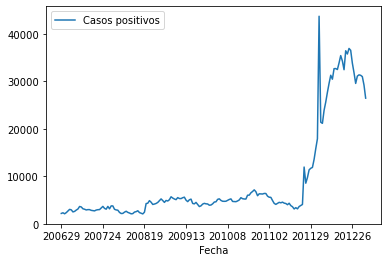

In [11]:
casos=new_df.groupby('Fecha').sum()
casos.plot()

In [12]:
casos.to_csv('Covid 19 Average by Date')
new_df.to_csv('Covid 19 by Date')

In [13]:
# 2020 csv files

# 200731_base_historica.csv (20-06-29 al 20-07-31)
# 200819_base_historica.csv (20-08-01 al 20-08-19)
# historico_sinave_sem1_ago20.csv (20-08-20 al 20-08-26)
# historico_sinave_sem2_ago20.csv (20-08-27 al 20-09-02)
# historico_sinave_sem36_ago20.csv (20-08-31 al 20-09-06)
# historico-sinave.csv (20-09-05 al 20-12-13)
# historico_sinave_sem51_dic20.csv (20-12-14 al 20-12-20)
# historico_sinave_sem52_dic20.csv (20-12-21 al 20-12-27)
# historico_sinave_sem53_dic20.csv (20-12-28 al 21-01-03)

# 2021 csv files
# historico_sinave_sem1_ene21.csv (21-01-04 AL 21-01-10)
# historico_sinave_sem2_ene21.csv (21-01-11 al 21-01-17)
# historico_sinave_sem3_ene21.csv (21-01-18 al 21-01-24)
# historico_sinave_sem4_ene21.csv (21-01-25 al 21-01-31)
# historico_sinave_sem5_ene21.csv (21-02-01 al 21-02-07)
# historico_sinave_sem6_feb21.csv (21-02-08 al 21-02-14)
# historico_sinave_sem7_feb21.csv (21-02-15 al 21-02-21)
# historico_sinave_sem8_feb21.csv (21-02-22 al 21-02-28)
# historico_sinave_sem9_feb21.csv (21-03-01 al 21-03-07)
# historico_sinave_sem10_mar21.csv
# historico_sinave_sem11_mar21.csv
# historico_sinave_sem12_mar21.csv

In [14]:
## Color Maped Casses


In [15]:
new_df['Fecha'] = pd.to_datetime(new_df['Fecha'], format='%y%m%d')
new_df

,Clave,Fecha,Casos positivos
0,05-011,2020-06-30,6.0
1,05-011,2020-09-03,8.0
2,05-011,2020-09-04,8.0
3,05-011,2020-09-05,7.0
4,05-011,2020-09-06,7.0
5,05-011,2020-09-07,7.0
6,05-011,2020-09-08,7.0
7,05-011,2020-09-09,7.0
8,05-011,2020-09-10,8.0
9,05-011,2020-09-11,7.0


In [16]:
print(new_df.dtypes)


Clave                      object
Fecha              datetime64[ns]
Casos positivos           float64
dtype: object


In [17]:
import numpy as np; np.random.seed(sum(map(ord, 'calmap')))
import pandas as pd
import calmap

all_days = pd.date_range('30/06/2020',  periods=185, freq='D')

In [18]:

casos_dia = new_df.groupby('Fecha')["Casos positivos"].sum()
casos_dia

Fecha
2020-06-29     2177.0
2020-06-30     2312.0
2020-07-01     2105.0
2020-07-02     2348.0
2020-07-03     2680.0
2020-07-04     3032.0
2020-07-05     2932.0
2020-07-06     2497.0
2020-07-07     2608.0
2020-07-08     2883.0
2020-07-09     3108.0
2020-07-10     3638.0
2020-07-11     3544.0
2020-07-12     3159.0
2020-07-13     3061.0
2020-07-14     2911.0
2020-07-15     2979.0
2020-07-16     2976.0
2020-07-17     2826.0
2020-07-18     2778.0
2020-07-19     2714.0
2020-07-20     2893.0
2020-07-21     2963.0
2020-07-22     2987.0
2020-07-23     3326.0
2020-07-24     3658.0
2020-07-26     3235.0
2020-07-27     3072.0
2020-07-28     3655.0
2020-07-29     3145.0
2020-07-30     3764.0
2020-07-31     3754.0
2020-08-01     3047.0
2020-08-02     2914.0
2020-08-03     2856.0
2020-08-04     2390.0
2020-08-05     2161.0
2020-08-06     2182.0
2020-08-07     2447.0
2020-08-08     2634.0
2020-08-09     2397.0
2020-08-10     2262.0
2020-08-11     2096.0
2020-08-12     2139.0
2020-08-13     2460.0
2020

In [34]:
semaforo = pd.read_csv("semaforo_fechas.csv")
semaforo.head()

,Fecha,Semaforo
0,2020-06-29,4
1,2020-06-30,4
2,2020-07-01,4
3,2020-07-02,4
4,2020-07-03,4


In [35]:
semaforo_df["Fecha"] = pd.to_datetime(semaforo["Fecha"], format='%y%m%d')
semaforo_df

ValueError: time data '2020-06-29' does not match format '%y%m%d' (match)

In [28]:
semaforo_grouped = semaforo.groupby('Fecha')["Semaforo"].sum()
semaforo_grouped.reset_index()

,Fecha,Semaforo
0,2020-06-29,4
1,2020-06-30,4
2,2020-07-01,4
3,2020-07-02,4
4,2020-07-03,4
5,2020-07-04,4
6,2020-07-05,4
7,2020-07-06,4
8,2020-07-07,4
9,2020-07-08,4


In [31]:
semaforo_df["Fecha"] = pd.to_datetime(semaforo_grouped["Fecha"], format='%y%m%d')
semaforo_df

KeyError: 'Fecha'

TypeError: Only valid with DatetimeIndex, TimedeltaIndex or PeriodIndex, but got an instance of 'Index'

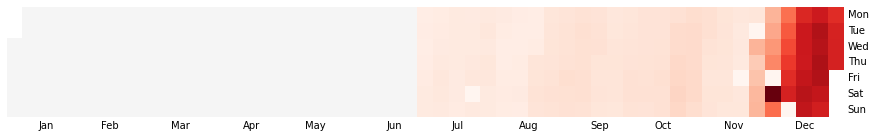

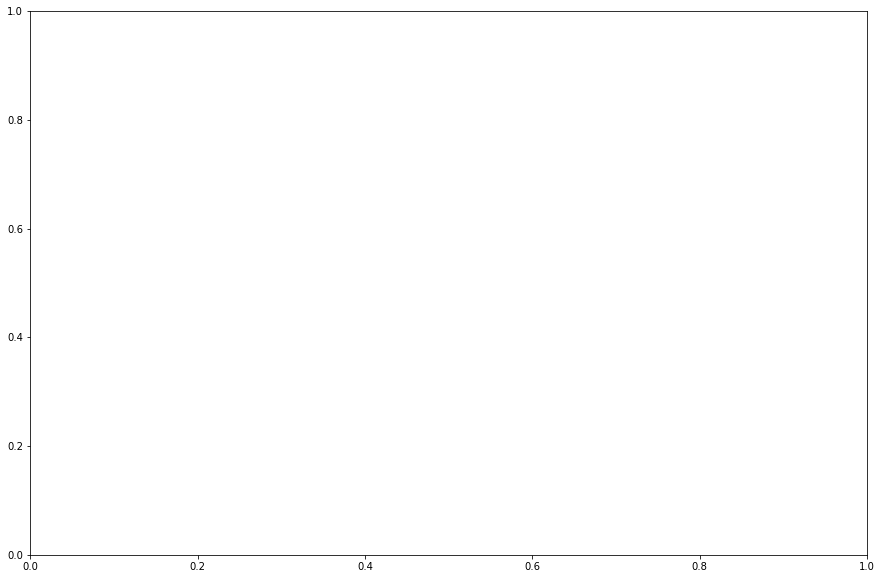

In [32]:
f1, ax = plt.subplots(1, 1, figsize = (15, 10))
calmap.yearplot(casos_dia, year=2020, linewidth=0)

f2, ax = plt.subplots(1, 1, figsize = (15, 10))
calmap.yearplot(semaforo_grouped, year=2020, linewidth=0)

(<Figure size 576x288 with 2 Axes>,
 array([<AxesSubplot:ylabel='2020'>, <AxesSubplot:ylabel='2021'>],
       dtype=object))

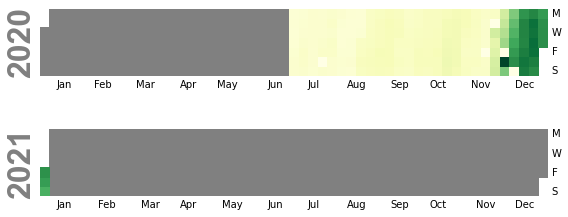

In [33]:
calmap.calendarplot(casos_dia, monthticks=3, daylabels='MTWTFSS',
                    dayticks=[0, 2, 4, 6], cmap='YlGn',
                    fillcolor='grey', linewidth=0,
                    fig_kws=dict(figsize=(8, 4)))

In [ ]:
aa

In [ ]:
## Color Maped Casses
